# M5 - WEEK 5 | PROJECT:  TRAFFIC CONGESTION IN 4 MAJOR US CITIES.

# Introduction

Welcome to our data science project on analyzing and predicting traffic congestion at intersections. This project is conducted by Manos and Takis, two data science master students passionate about exploring the impact of various factors on traffic conditions.

The objective of this project is to gain insights into how different factors, such as time of day, month, and weekend, influence congestion levels at intersections. By analyzing and modeling traffic data from multiple cities, including Atlanta, Boston, Chicago, and Philadelphia, we aim to develop a predictive model that can estimate the total time vehicles spend stopped at intersections.

Our project follows a structured approach that involves data exploration, preprocessing, modeling, and performance evaluation. We begin by examining the dataset and identifying relevant features related to congestion, such as time from first stop, distance to first stop, and total time stopped. We also consider additional factors like the day of the week, month, and hour of the day.

Using linear regression as our modeling technique, we train separate models for each city to understand the specific congestion patterns and factors affecting traffic conditions. We evaluate the performance of our models using metrics such as Root Mean Squared Error (RMSE), Mean Absolute Error (MAE), and R-squared.

To further validate our model's effectiveness, we test it on a separate dataset containing different values for the weekend, month, and hour. By comparing the performance of the model on this new dataset with our initial results, we gain insights into the generalizability and reliability of our predictions.

Through this project, we aim to provide valuable insights for traffic management and urban planning. By understanding the impact of various factors on congestion, we can make informed decisions to optimize traffic flow and improve overall transportation efficiency.

Join us on this journey as we delve into the world of traffic analysis, modeling, and prediction, and uncover the hidden patterns influencing congestion at intersections.

*****************************

# Dataset Description

The data consists of aggregated trip logging metrics from commercial vehicles, such as semi-trucks. The data have been grouped by intersection, month, hour of day, direction driven through the intersection, and whether the day was on a weekend or not. Additionally, our two datasets (train and test dataframes) consist of the following columns for further analysis.

- RowId: Represents a unique row ID in the dataframe.
- IntersectionId: Represents a unique intersectionID for some intersection of roads within a city.
- Latitude: The latitude of the intersection.
- Longitude: The longitude of the intersection.
- EntryStreetName: The street name from which the vehicle entered towards the intersection.
- ExitStreetName: The street name to which the vehicle goes from the intersection.
- EntryHeading: Direction to which the car was heading while entering the intersection.
- ExitHeading: Direction to which the car went after it went through the intersection.
- Hour: The hour of the day.
- Weekend: It's weekend or not.
- Month: Which Month it is.
- Path: It is a concatination in the format: EntryStreetName_EntryHeading ExitStreetName_ExitHeading.
- TotalTimeStopped_p20: Total time for which 20% of the vehicles had to stop at an intersection.
- TotalTimeStopped_p40: Total time for which 40% of the vehicles had to stop at an intersection.
- TotalTimeStopped_p50: Total time for which 50% of the vehicles had to stop at an intersection.
- TotalTimeStopped_p60: Total time for which 60% of the vehicles had to stop at an intersection.
- TotalTimeStopped_p80: Total time for which 80% of the vehicles had to stop at an intersection.
- TimeFromFirstStop_p20: Time taken for 20% of the vehicles to stop again after crossing a intersection.
- TimeFromFirstStop_p40: Time taken for 40% of the vehicles to stop again after crossing a intersection.
- TimeFromFirstStop_p50: Time taken for 50% of the vehicles to stop again after crossing a intersection.
- TimeFromFirstStop_p60: Time taken for 60% of the vehicles to stop again after crossing a intersection.
- TimeFromFirstStop_p80: Time taken for 80% of the vehicles to stop again after crossing a intersection.
- DistanceToFirstStop_p20: How far before the intersection the 20% of the vehicles stopped for the first time.
- DistanceToFirstStop_p40: How far before the intersection the 40% of the vehicles stopped for the first time.
- DistanceToFirstStop_p50: How far before the intersection the 50% of the vehicles stopped for the first time.
- DistanceToFirstStop_p60: How far before the intersection the 60% of the vehicles stopped for the first time.
- DistanceToFirstStop_p80: How far before the intersection the 80% of the vehicles stopped for the first time.
- City: Name of the city

*****************************

# Exploratory Data Analysis

In the initial step of our assignment, we will perform Exploratory Data Analysis (EDA) to gain a better understanding of the dataset. EDA involves examining the data's structure, identifying patterns, and extracting meaningful insights. This step will provide us with a foundation for further analysis and modeling.

During the EDA process, we will focus on various aspects of the data, such as the distribution of variables, the presence of missing values, and the identification of outliers. We will also explore the relationships between different features and their impact on our target variable, which in this case is congestion at intersections.

By conducting a thorough EDA, we aim to uncover important insights, discover any data anomalies, and gain a deeper understanding of the dataset's characteristics. This knowledge will guide us in subsequent steps, including data preprocessing, feature engineering, and model selection.

### 1) Data Cleaning

In [197]:
#loading the data 
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import folium
from folium.plugins import HeatMap

os.chdir("C:\\Users\\ManosIeronymakisProb\\OneDrive - Probability\\Bureaublad\\ELU\\M5 - WEEK 5  PROJECT Kaggle Competition")
filepath_test =  "test.csv"
filepath_train = "train.csv"
df_test = pd.read_csv(filepath_test)
df_train = pd.read_csv(filepath_train)

In [186]:
# Check for null values in the train dataframe
null_values = df_train.isnull().sum()

#Print the number of null values in each column
print('Sum of null values in train:')
print(null_values)

sum of null values in train:
RowId                         0
IntersectionId                0
Latitude                      0
Longitude                     0
EntryStreetName            8148
ExitStreetName             6287
EntryHeading                  0
ExitHeading                   0
Hour                          0
Weekend                       0
Month                         0
Path                          0
TotalTimeStopped_p20          0
TotalTimeStopped_p40          0
TotalTimeStopped_p50          0
TotalTimeStopped_p60          0
TotalTimeStopped_p80          0
TimeFromFirstStop_p20         0
TimeFromFirstStop_p40         0
TimeFromFirstStop_p50         0
TimeFromFirstStop_p60         0
TimeFromFirstStop_p80         0
DistanceToFirstStop_p20       0
DistanceToFirstStop_p40       0
DistanceToFirstStop_p50       0
DistanceToFirstStop_p60       0
DistanceToFirstStop_p80       0
City                          0
dtype: int64


In [187]:
# Check for null values in the test dataframe
null_values = df_test.isnull().sum()

#Print the number of null values in each column
print('Sum of null values in test:')
print(null_values)

sum of null values in test:
RowId                  0
IntersectionId         0
Latitude               0
Longitude              0
EntryStreetName    19198
ExitStreetName     15587
EntryHeading           0
ExitHeading            0
Hour                   0
Weekend                0
Month                  0
Path                   0
City                   0
dtype: int64


In [188]:
#check for duplicates in both dataframes
print('Number of duplicates in train:',df_train.duplicated().sum())
print('Number of duplicates in test:',df_test.duplicated().sum())

Number of duplicates in train: 0
Number of duplicates in test: 0


In [189]:
#Ratio of missing data in Train/Test dataset
print('Ratio of missing data in Train set:')
df_train[['EntryStreetName','ExitStreetName']].isna().sum() / df_train.shape[0]

Ratio of missing data in Train set:


EntryStreetName    0.009514
ExitStreetName     0.007341
dtype: float64

In [195]:
# Find the common columns
common_columns = df_train.columns.intersection(df_test.columns)

# Find the extra columns in the train dataset
extra_columns = df_train.columns.difference(df_test.columns)

# Print the common columns
print("Common Columns:")
print(common_columns)

# Print the extra columns in the train dataset
print("\nExtra Columns in Train Dataset:")
print(extra_columns)

Common Columns:
Index(['RowId', 'IntersectionId', 'Latitude', 'Longitude', 'EntryStreetName',
       'ExitStreetName', 'EntryHeading', 'ExitHeading', 'Hour', 'Weekend',
       'Month', 'Path', 'City'],
      dtype='object')

Extra Columns in Train Dataset:
Index(['DistanceToFirstStop_p20', 'DistanceToFirstStop_p40',
       'DistanceToFirstStop_p50', 'DistanceToFirstStop_p60',
       'DistanceToFirstStop_p80', 'TimeFromFirstStop_p20',
       'TimeFromFirstStop_p40', 'TimeFromFirstStop_p50',
       'TimeFromFirstStop_p60', 'TimeFromFirstStop_p80',
       'TotalTimeStopped_p20', 'TotalTimeStopped_p40', 'TotalTimeStopped_p50',
       'TotalTimeStopped_p60', 'TotalTimeStopped_p80'],
      dtype='object')


### 2) Data Visualisation

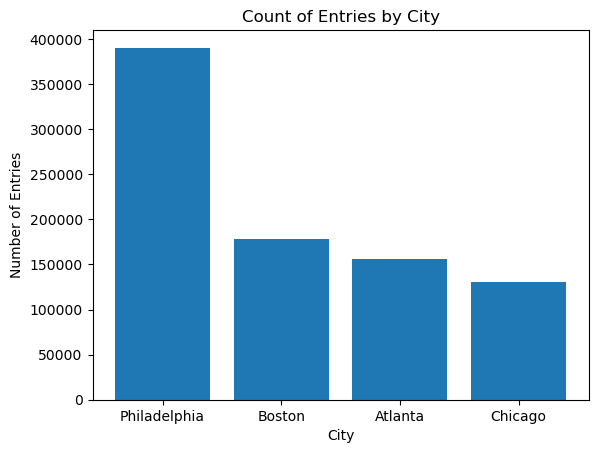

Count of Entries by City:


City
Philadelphia    390237
Boston          178617
Atlanta         156484
Chicago         131049
Name: count, dtype: int64

In [190]:
#first we see how many entries we have for each city 
cities = df_train.iloc[:,-1].value_counts()
plt.bar(cities.index, cities.values)
plt.title("Count of Entries by City")
plt.ylabel("Number of Entries")
plt.xlabel("City")  
plt.show()
print("Count of Entries by City:")
cities

- Philadelphia seems to have the highest number of data points available, suggesting that there is a rich dataset for conducting detailed analysis and exploration of intersection congestion in that city.

Text(0.5, 0.98, 'Hourly Traffic on Weekends')

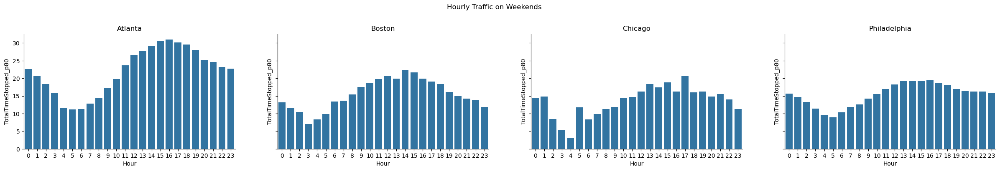

In [191]:
# Filter the data for weekends
weekend_data = df_train[df_train['Weekend'] == 1]

# Calculate the mean of 'TotalTimeStopped_p80' for each city and hour
grouped_data = weekend_data.groupby(['City', 'Hour']).agg({'TotalTimeStopped_p80': 'mean'}).reset_index()

# Create subplots for each city
fig, axes = plt.subplots(nrows=1, ncols=grouped_data['City'].nunique(), figsize=(30, 4), sharey=True)

# Iterate over unique cities and plot the bar chart
for i, city in enumerate(grouped_data['City'].unique()):
    sns.barplot(data=grouped_data[grouped_data['City'] == city], x='Hour', y='TotalTimeStopped_p80', ax=axes[i], color='C0')
    axes[i].set_title(city)
    axes[i].spines['top'].set_visible(False)
    axes[i].spines['right'].set_visible(False)

# Adjust the spacing between subplots and add a title
plt.subplots_adjust(top=0.8)
fig.suptitle('Hourly Traffic on Weekends')

- With an average wait time of 9.7 seconds and a distance to the nearest intersection of 30 "meters," Atlanta is the most congested city, followed by Boston and Chicago.

Text(0, 0.5, 'Number of Entries')

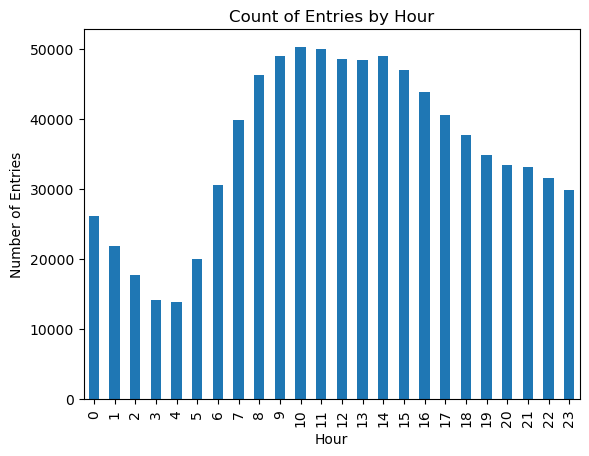

In [192]:
#number of entries by hour
hour = df_train['Hour'].value_counts()
hour.sort_index().plot(kind='bar')
plt.title("Count of Entries by Hour")
plt.xlabel("Hour")
plt.ylabel("Number of Entries")

- Upon analyzing the results, we observed that the busiest hours of the day occur between 8 am and 3 pm. During this time period, congestion at intersections reaches its peak, indicating high traffic volumes and potentially longer delays for vehicles passing through these areas. This finding highlights the importance of considering this specific time range when evaluating traffic conditions and planning transportation strategies. By understanding the patterns of congestion during these hours, stakeholders can make informed decisions to alleviate traffic congestion and improve overall transportation efficiency.

In [193]:
# type of streets can be identified from the Street Name
df = df_train[['City','EntryStreetName','IntersectionId']].drop_duplicates()
print("Number of Avenues :", df['EntryStreetName'].str.contains('Avenue').sum())
print("Number of Streets :", df['EntryStreetName'].str.contains('Street').sum())
print("Number of Boulevards :", df['EntryStreetName'].str.contains('Boulevard').sum())
print("Number of Roads:", df['EntryStreetName'].str.contains('Road').sum())
print("Number of Highways :", df['EntryStreetName'].str.contains('Highway').sum())
print("Number of Drives :", df['EntryStreetName'].str.contains('Drive').sum())
print("Number of Parkways :", df['EntryStreetName'].str.contains('Parkway').sum())

Number of Avenues : 2420
Number of Streets : 4451
Number of Boulevards : 471
Number of Roads: 427
Number of Highways : 27
Number of Drives : 347
Number of Parkways : 91


- With 2,420 avenues included in the dataset, this road type is clearly present.The 4,451 streets total suggests there are many more localized, smaller roads.This road category, which has 471 boulevards, symbolizes longer, more picturesque roadways that frequently include planted medians.A generic category for roads that do not fit into more specific types like avenues, streets, or boulevards is shown by the count of 427 roads.The fact that there are just 27 highways indicates that local roads rather than significant motorways or expressways are the priority.The collection contains 347 drives, which is a reasonable number of roads that are frequently found in residential areas, parks, or scenic routes.The presence of 91 parkways indicates that there are roads that pass through parks or other open areas.

C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2663048403.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_temp['StreetType'] = df_temp['EntryStreetName'].apply(encode)
C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2663048403.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_temp['avg_time'] = temp
C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2663048403.py:47: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the 

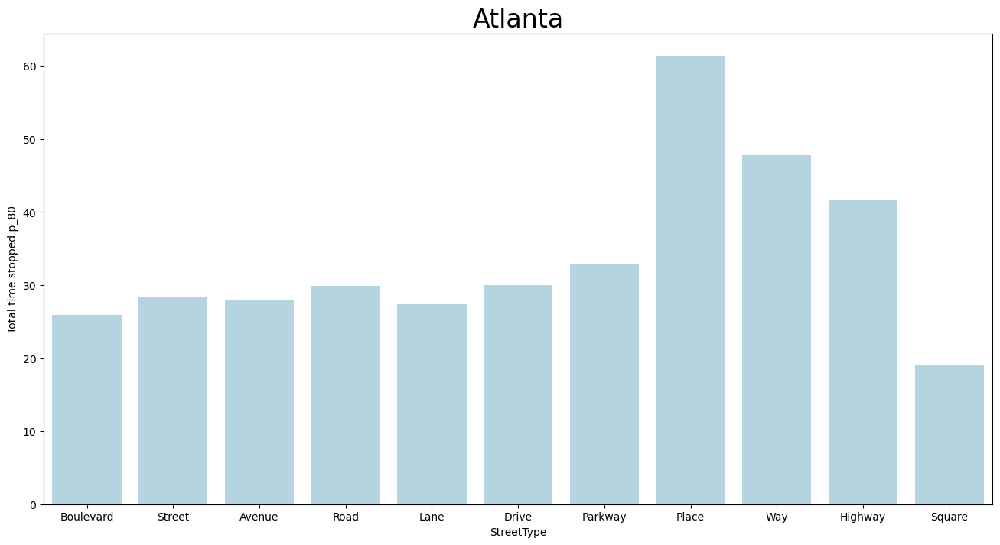

C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2663048403.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_temp['StreetType'] = df_temp['EntryStreetName'].apply(encode)
C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2663048403.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_temp['avg_time'] = temp
C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2663048403.py:47: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the 

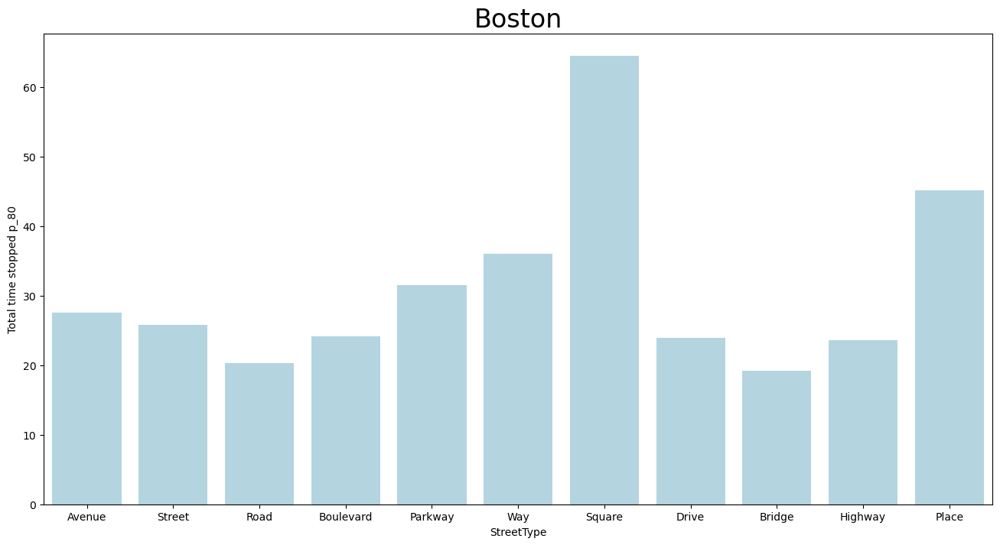

C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2663048403.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_temp['StreetType'] = df_temp['EntryStreetName'].apply(encode)
C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2663048403.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_temp['avg_time'] = temp
C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2663048403.py:47: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the 

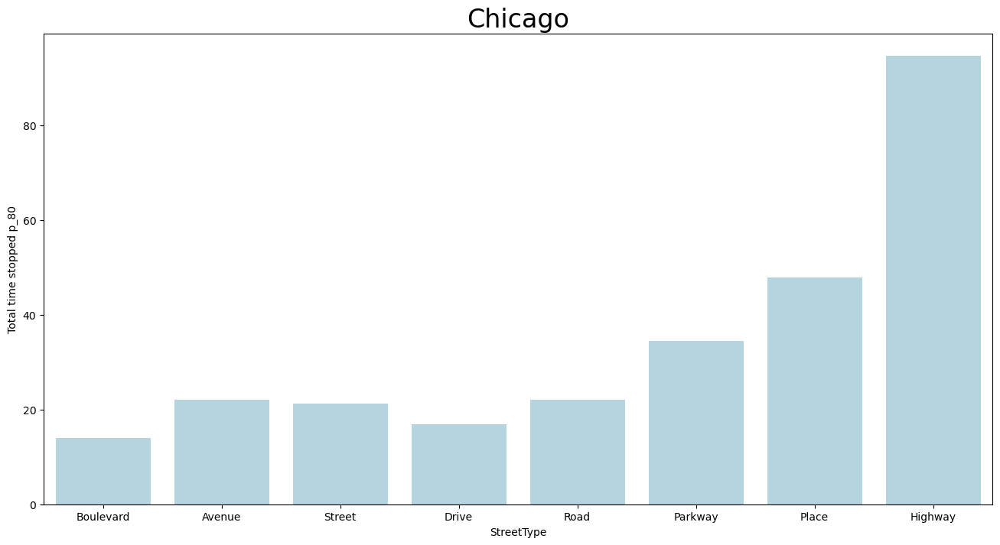

C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2663048403.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_temp['StreetType'] = df_temp['EntryStreetName'].apply(encode)
C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2663048403.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_temp['avg_time'] = temp
C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2663048403.py:47: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the 

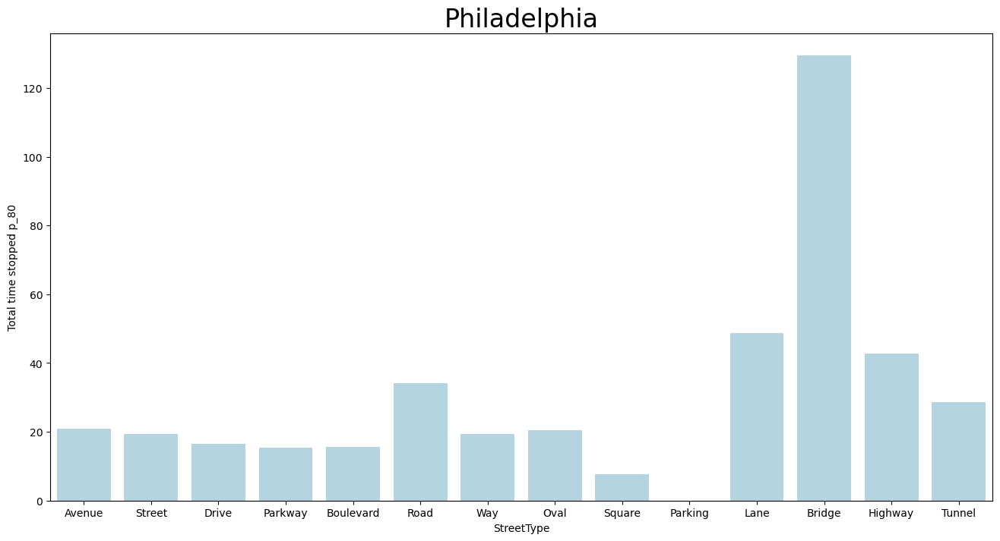

In [194]:
# This code snippet encodes the street types in the 'EntryStreetName' column and visualizes the average total time stopped at intersections for each street type in different cities.
road_encoding = {
    "Street": "Street",
    "St": "Street",
    "Avenue": "Avenue",
    "Ave": "Avenue",
    "Boulevard": "Boulevard",
    "Road": "Road",
    "Drive": "Drive",
    "Lane": "Lane",
    "Tunnel": "Tunnel",
    "Highway": "Highway",
    "Way": "Way",
    "Parkway": "Parkway",
    "Parking": "Parking",
    "Oval": "Oval",
    "Square": "Square",
    "Place": "Place",
    "Bridge": "Bridge",
}

# Function to encode the street type based on a predefined mapping
def encode(x):
    if pd.isna(x):
        return "Street"
    for road in road_encoding.keys():
        if road in x:
            return road_encoding[road]
    return "Street"

# Iterate over each unique city in the 'City' column of the train dataset
for city in df_train['City'].unique():
    # Create a temporary dataframe for the current city
    df_temp = df_train[df_train['City'] == city]
    
    # Apply the encoding function to the 'EntryStreetName' column to get the encoded street types
    df_temp['StreetType'] = df_temp['EntryStreetName'].apply(encode)
    
    # Calculate the average total time stopped (p_80) for each street type and hour combination
    temp = df_temp.sort_values('StreetType').groupby(by=['Hour', 'StreetType'])['TotalTimeStopped_p80'].transform(lambda x: x.mean())
    
    # Add the calculated average time stopped as a new column in the temporary dataframe
    df_temp['avg_time'] = temp
    
    # Create a bar plot to visualize the average time stopped for each street type
    fig, axs = plt.subplots(figsize=(16, 8))
    axs = sns.barplot(x='StreetType', y='avg_time', data=df_temp, ax=axs, ci=None, color='lightblue')
    axs.set_xlabel('StreetType')
    axs.set_ylabel('Total time stopped p_80')
    axs.set_title(city, fontsize=24)
    plt.show()


- Atlanta: It's interesting to note that Atlanta has the most 'Place' streets among the cities. 'Place' is a street type often associated with cul-de-sacs or small, enclosed areas. This could suggest that Atlanta has a higher concentration of neighborhoods or subdivisions with circular or dead-end road layouts, providing a more localized and secluded environment.

- Boston: The fact that Boston has the most squares in the street type is noteworthy. Squares often refer to open public spaces or intersections that serve as focal points within a city. Boston's prominence in this street type may indicate a significant presence of historically significant or architecturally important squares, contributing to the city's urban landscape and cultural identity.

- Chicago: It's intriguing that Chicago has the most highways among the cities. Highways are major roadways designed for high-speed, long-distance travel and often connect different regions or cities. Chicago's large number of highways suggests its role as a transportation hub, linking various parts of the city and serving as an important thoroughfare for regional and interstate travel.

- Philadelphia: The fact that Philadelphia has the most bridges is notable. Bridges are crucial transportation infrastructure that allows passage over bodies of water or other barriers. Philadelphia's high count of bridges suggests its geographical features, such as rivers or other water bodies, that necessitate a significant number of bridge structures for efficient transportation and connectivity.

### 3) Map-based data visualization insights.

In the final part of our visualizations, we will explore the spatial distribution of intersections in each major city using an interactive map. This map will allow us to gain insights into the geographical locations of the intersections and identify any overlapping areas between the training and test datasets.

By examining the map, we can observe the distribution and density of intersections across the city. We have assigned different marker colors to indicate the source of each intersection:

- Blue markers represent intersections from the training dataset (df_train).
- Green markers represent intersections from the test dataset (df_test).
- Red markers represent intersections that are common to both the training and test datasets.

Using the interactive features of the map, we can zoom in and out to explore specific areas of interest within each city. Furthermore, by clicking on the markers, we can access additional information about each intersection, such as whether it belongs to the training data, test data, or both.

This visualization provides a comprehensive overview of the intersection locations and their distribution across the major cities. It allows us to identify any similarities or differences between the training and test datasets, providing valuable insights for further analysis and decision-making in traffic management and planning.

### Atlanta

In [215]:
import folium
from folium.plugins import MarkerCluster

def draw_train_test_intersections(city, df_train, df_test):
    df_draw = df_train[df_train['City'] == city]
    df_draw = df_draw[['Latitude','Longitude']]
    df_draw.drop_duplicates(inplace=True)
    df_draw1 = df_test[df_test['City'] == city]
    df_draw1 = df_draw1[['Latitude', 'Longitude']]
    df_draw1.drop_duplicates(inplace=True)
    
    df_common = pd.merge(df_draw, df_draw1, how='inner')
    df_common.drop_duplicates(inplace=True)
    
    # Create the map centered at the default location
    m = folium.Map(location=[df_draw['Latitude'].mean(), df_draw['Longitude'].mean()], zoom_start=10)
    
    # Create marker clusters for train and test data
    train_cluster = MarkerCluster().add_to(m)
    test_cluster = MarkerCluster().add_to(m)
    common_cluster = MarkerCluster().add_to(m)
    
    # Add markers to the marker clusters
    for _, row in df_draw.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            icon=folium.Icon(color='blue', icon='train'),
            popup='Train'
        ).add_to(train_cluster)
    
    for _, row in df_draw1.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            icon=folium.Icon(color='green', icon='cloud'),
            popup='Test'
        ).add_to(test_cluster)
    
    for _, row in df_common.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            icon=folium.Icon(color='red', icon='star'),
            popup='Common'
        ).add_to(common_cluster)
    
    return m

# Draw the map for Atlanta
city = 'Atlanta'
fig = draw_train_test_intersections(city, df_train, df_test)
fig

### Boston

In [214]:
import folium
from folium.plugins import MarkerCluster

def draw_train_test_intersections(city, df_train, df_test):
    df_draw = df_train[df_train['City'] == city]
    df_draw = df_draw[['Latitude','Longitude']]
    df_draw.drop_duplicates(inplace=True)
    df_draw1 = df_test[df_test['City'] == city]
    df_draw1 = df_draw1[['Latitude', 'Longitude']]
    df_draw1.drop_duplicates(inplace=True)
    
    df_common = pd.merge(df_draw, df_draw1, how='inner')
    df_common.drop_duplicates(inplace=True)
    
    # Create the map centered at the default location
    m = folium.Map(location=[df_draw['Latitude'].mean(), df_draw['Longitude'].mean()], zoom_start=10)
    
    # Create marker clusters for train and test data
    train_cluster = MarkerCluster().add_to(m)
    test_cluster = MarkerCluster().add_to(m)
    common_cluster = MarkerCluster().add_to(m)
    
    # Add markers to the marker clusters
    for _, row in df_draw.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            icon=folium.Icon(color='blue', icon='train'),
            popup='Train'
        ).add_to(train_cluster)
    
    for _, row in df_draw1.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            icon=folium.Icon(color='green', icon='cloud'),
            popup='Test'
        ).add_to(test_cluster)
    
    for _, row in df_common.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            icon=folium.Icon(color='red', icon='star'),
            popup='Common'
        ).add_to(common_cluster)
    
    return m

# Draw the map for Atlanta
city = 'Boston'
fig = draw_train_test_intersections(city, df_train, df_test)
fig

### Chicago

In [213]:
import folium
from folium.plugins import MarkerCluster

def draw_train_test_intersections(city, df_train, df_test):
    df_draw = df_train[df_train['City'] == city]
    df_draw = df_draw[['Latitude','Longitude']]
    df_draw.drop_duplicates(inplace=True)
    df_draw1 = df_test[df_test['City'] == city]
    df_draw1 = df_draw1[['Latitude', 'Longitude']]
    df_draw1.drop_duplicates(inplace=True)
    
    df_common = pd.merge(df_draw, df_draw1, how='inner')
    df_common.drop_duplicates(inplace=True)
    
    # Create the map centered at the default location
    m = folium.Map(location=[df_draw['Latitude'].mean(), df_draw['Longitude'].mean()], zoom_start=10)
    
    # Create marker clusters for train and test data
    train_cluster = MarkerCluster().add_to(m)
    test_cluster = MarkerCluster().add_to(m)
    common_cluster = MarkerCluster().add_to(m)
    
    # Add markers to the marker clusters
    for _, row in df_draw.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            icon=folium.Icon(color='blue', icon='train'),
            popup='Train'
        ).add_to(train_cluster)
    
    for _, row in df_draw1.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            icon=folium.Icon(color='green', icon='cloud'),
            popup='Test'
        ).add_to(test_cluster)
    
    for _, row in df_common.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            icon=folium.Icon(color='red', icon='star'),
            popup='Common'
        ).add_to(common_cluster)
    
    return m

# Draw the map for Atlanta
city = 'Chicago'
fig = draw_train_test_intersections(city, df_train, df_test)
fig

### Philadelphia

In [212]:
import folium
from folium.plugins import MarkerCluster

def draw_train_test_intersections(city, df_train, df_test):
    df_draw = df_train[df_train['City'] == city]
    df_draw = df_draw[['Latitude','Longitude']]
    df_draw.drop_duplicates(inplace=True)
    df_draw1 = df_test[df_test['City'] == city]
    df_draw1 = df_draw1[['Latitude', 'Longitude']]
    df_draw1.drop_duplicates(inplace=True)
    
    df_common = pd.merge(df_draw, df_draw1, how='inner')
    df_common.drop_duplicates(inplace=True)
    
    # Create the map centered at the default location
    m = folium.Map(location=[df_draw['Latitude'].mean(), df_draw['Longitude'].mean()], zoom_start=10)
    
    # Create marker clusters for train and test data
    train_cluster = MarkerCluster().add_to(m)
    test_cluster = MarkerCluster().add_to(m)
    common_cluster = MarkerCluster().add_to(m)
    
    # Add markers to the marker clusters
    for _, row in df_draw.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            icon=folium.Icon(color='blue', icon='train'),
            popup='Train'
        ).add_to(train_cluster)
    
    for _, row in df_draw1.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            icon=folium.Icon(color='green', icon='cloud'),
            popup='Test'
        ).add_to(test_cluster)
    
    for _, row in df_common.iterrows():
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            icon=folium.Icon(color='red', icon='star'),
            popup='Common'
        ).add_to(common_cluster)
    
    return m

# Draw the map for Atlanta
city = 'Philadelphia'
fig = draw_train_test_intersections(city, df_train, df_test)
fig

********************************

# Understanding the Impact of Traffic Conditions on Intersection Congestion

In this analysis, we aim to understand how various factors, such the month, the weekdays and time, impact congestion at intersections. We follow a step-by-step approach to study congestion patterns in different cities, train a linear regression model, and evaluate its performance using relevant metrics. Finally, we utilize a test dataset to further assess the model's accuracy and visualize the impact of factors on congestion in each state.

Step 1: Dataset Division and City-Specific Analysis

We start by dividing our training dataset into smaller subsets based on the cities of Atlanta, Boston, Chicago, and Philadelphia. This division allows us to study congestion patterns in each city independently and gain insights into location-specific factors affecting congestion.

Step 2: Linear Regression Modeling

For each city-specific dataset, we train a linear regression model using five attributes: 'TimeFromFirstStop', 'DistanceToFirstStop', 'Weekend', 'Month', and 'Hour'. The 'TotalTimeStopped' column represents the target variable, indicating overall congestion at intersections. Additional columns such as 'TimeFromFirstStop', 'DistanceToFirstStop', and 'TotalTimeStopped' are derived by aggregating corresponding percentile columns.

Step 3: Performance Evaluation with RMSE, MAE, and R-squared

We utilize three metrics, namely Root Mean Squared Error (RMSE), Mean Absolute Error (MAE), and R-squared, to evaluate the performance of our linear regression model. Here are some reasons why we choose these metrics:

- RMSE (Root Mean Squared Error):

RMSE is a popular metric in regression analysis because it provides a measure of the average magnitude of prediction errors.

RMSE penalizes larger errors more heavily than MAE, making it suitable when larger errors have more significant consequences or need to be minimized.

By calculating the square root of the average squared difference between the predicted and actual values, RMSE provides a single, interpretable value representing the average error.

- MAE (Mean Absolute Error):

MAE is another commonly used metric that measures the average absolute difference between the predicted and actual values.

MAE provides a measure of the average magnitude of errors, irrespective of their direction, making it easier to interpret and understand.

MAE is less sensitive to outliers compared to RMSE, as it considers the absolute differences rather than squared differences.

- R-squared:

R-squared, also known as the coefficient of determination, provides an indication of how well the model fits the data.
It represents the proportion of the variance in the target variable that is explained by the model.

A higher R-squared value indicates a better fit, with values closer to 1 indicating a higher degree of explained variance.

R-squared is a useful metric for assessing the overall performance and goodness-of-fit of the regression model.

Using a combination of these metrics allows us to gain a comprehensive understanding of the model's performance from different perspectives. RMSE and MAE provide insights into the accuracy and magnitude of prediction errors, while R-squared offers information on the overall fit of the model to the data. By considering multiple metrics together, we obtain a more complete picture of the model's performance and can make informed decisions regarding its effectiveness in predicting congestion at intersections.

Step 4: Testing the Model with New Data

We apply the trained model to a provided test dataset, which includes different values for 'Weekend', 'Month', and 'Hour'. To accomplish this, we create a new DataFrame called 'new_df' containing common columns from both the training and test datasets. After cleaning the data, we split 'new_df' into state-specific subsets.

Step 5: Combined Dataset and Model Comparison

We create the 'combined_df' by concatenating the existing three columns from the training dataset ('TimeFromFirstStop', 'DistanceToFirstStop', and 'TotalTimeStopped') with the three new columns from the test dataset ('Weekend', 'Month', and 'Hour'). We then apply our linear regression model to this combined dataset and compare the results to the previous model. The model with higher evaluation metric scores indicates greater reliability.

Step 6: Visualization and Interpretation

Finally, we plot the results for each state, visualizing the impact of various factors on congestion at intersections. This allows us to better understand how traffic conditions, such as weather, time, and other relevant factors, influence congestion levels.

By following this comprehensive analysis, we gain insights into the relationship between traffic conditions and intersection congestion, allowing for better planning and decision-making in traffic management.


### First we combine train and test dataframes.

In [154]:
import pandas as pd

# Get the common columns between df_train and df_test
common_columns = list(set(df_train.columns).intersection(df_test.columns))

# Create a new DataFrame to store the merged data
new_df = pd.concat([df_train[common_columns], df_test[common_columns]], ignore_index=True)

# Calculate the number of duplicates in the new DataFrame
num_duplicates = new_df.duplicated().sum()

# Display the number of duplicates
print("Number of duplicates:", num_duplicates)

# Remove rows with NaN values in-place
new_df.dropna(inplace=True)

nan_counts = new_df.isna().sum()
total_nan_count = nan_counts.sum()

print("Total NaN count:", total_nan_count)

Number of duplicates: 0
Total NaN count: 0


# Atlanda analysis

### Model with train dataframe

In [160]:
# Filter the data for Atlanta
atlanta_train_df = df_train[df_train['City'] == 'Atlanta']

#create our main columns 
atlanta_train_df.loc[:, 'TotalTimeStopped'] = atlanta_train_df[['TotalTimeStopped_p20', 'TotalTimeStopped_p40', 'TotalTimeStopped_p50', 'TotalTimeStopped_p60', 'TotalTimeStopped_p80']].sum(axis=1)
atlanta_train_df.loc[:, 'TimeFromFirstStop'] = atlanta_train_df[['TimeFromFirstStop_p20', 'TimeFromFirstStop_p40', 'TimeFromFirstStop_p50', 'TimeFromFirstStop_p60', 'TimeFromFirstStop_p80']].sum(axis=1)
atlanta_train_df.loc[:, 'DistanceToFirstStop'] = atlanta_train_df[['DistanceToFirstStop_p20', 'DistanceToFirstStop_p40', 'DistanceToFirstStop_p50', 'DistanceToFirstStop_p60', 'DistanceToFirstStop_p80']].sum(axis=1)


C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2554170598.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  atlanta_train_df.loc[:, 'TotalTimeStopped'] = atlanta_train_df[['TotalTimeStopped_p20', 'TotalTimeStopped_p40', 'TotalTimeStopped_p50', 'TotalTimeStopped_p60', 'TotalTimeStopped_p80']].sum(axis=1)
C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2554170598.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  atlanta_train_df.loc[:, 'TimeFromFirstStop'] = atlanta_trai

In [161]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Split the dataset into features (X) and target variable (y)
X = atlanta_train_df[['TimeFromFirstStop', 'DistanceToFirstStop', 'Weekend', 'Month', 'Hour']]
y = atlanta_train_df['TotalTimeStopped']  # Choose the target variable representing overall congestion

# Split the data into training and testing subsets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test subset
y_pred = model.predict(X_test)

# Evaluate the model performance
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("RMSE:", rmse)
print("MAE:", mae)
print("R-squared:", r2)

# Interpret the model coefficients
coefficients = pd.DataFrame({'Feature': X.columns, 'Coefficient': model.coef_})
print(coefficients)

# Analyze the impact of features on congestion
hour_coefficient = coefficients.loc[coefficients['Feature'] == 'Hour', 'Coefficient'].values[0]
month_coefficient = coefficients.loc[coefficients['Feature'] == 'Month', 'Coefficient'].values[0]
weekend_coefficient = coefficients.loc[coefficients['Feature'] == 'Weekend', 'Coefficient'].values[0]

print("Impact of Hour on congestion:", hour_coefficient)
print("Impact of Month on congestion:", month_coefficient)
print("Impact of Weekend on congestion:", weekend_coefficient)



RMSE: 15.64386338396926
MAE: 7.4734835938700215
R-squared: 0.9714839235461165
               Feature  Coefficient
0    TimeFromFirstStop     0.832587
1  DistanceToFirstStop    -0.071495
2              Weekend     1.036356
3                Month    -0.048951
4                 Hour    -0.078933
Impact of Hour on congestion: -0.07893344418682526
Impact of Month on congestion: -0.04895066245632944
Impact of Weekend on congestion: 1.0363555530596027


### Model with train and test dataframe

In [136]:
#from new_df we are taking the cases for atlanta
atlanta_new_df = new_df[new_df['City'] == 'Atlanta']

# Randomly select 156484 rows from the Atlanta test dataset
atlanta_train_subset = atlanta_new_df.sample(n=156484, random_state=42)

#from_atlanta_df we keep only the 3 columns that we dont have new data
atlanta_train_df = atlanta_train_df[['TimeFromFirstStop', 'DistanceToFirstStop', 'TotalTimeStopped']]
#we reset the indexes in both  dataframes in order to concat them after 
atlanta_train_df = atlanta_train_df.reset_index(drop=True)
atlanta_train_subset = atlanta_train_subset.reset_index(drop=True)

# Concatenate the DataFrames
combined_atlanta_df = pd.concat([atlanta_train_df, atlanta_train_subset], axis=1)

In [137]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Split the dataset into features (X) and target variable (y)
X = combined_atlanta_df[['TimeFromFirstStop', 'DistanceToFirstStop', 'Weekend', 'Month', 'Hour']]
y = combined_atlanta_df['TotalTimeStopped']  # Choose the target variable representing overall congestion

# Split the data into training and testing subsets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test subset
y_pred = model.predict(X_test)

# Evaluate the model performance
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("RMSE:", rmse)
print("MAE:", mae)
print("R-squared:", r2)

# Interpret the model coefficients
coefficients = pd.DataFrame({'Feature': X.columns, 'Coefficient': model.coef_})
print(coefficients)

# Analyze the impact of features on congestion
hour_coefficient = coefficients.loc[coefficients['Feature'] == 'Hour', 'Coefficient'].values[0]
month_coefficient = coefficients.loc[coefficients['Feature'] == 'Month', 'Coefficient'].values[0]
weekend_coefficient = coefficients.loc[coefficients['Feature'] == 'Weekend', 'Coefficient'].values[0]

print("Impact of Hour on congestion:", hour_coefficient)
print("Impact of Month on congestion:", month_coefficient)
print("Impact of Weekend on congestion:", weekend_coefficient)



RMSE: 15.657631208901469
MAE: 7.418594620540273
R-squared: 0.9714337086982855
               Feature  Coefficient
0    TimeFromFirstStop     0.831632
1  DistanceToFirstStop    -0.071412
2              Weekend     0.053147
3                Month     0.012435
4                 Hour     0.003044
Impact of Hour on congestion: 0.0030442668093029522
Impact of Month on congestion: 0.012434678416453297
Impact of Weekend on congestion: 0.053147079293611926


### Plot the Hour, Month and Weekend congestion

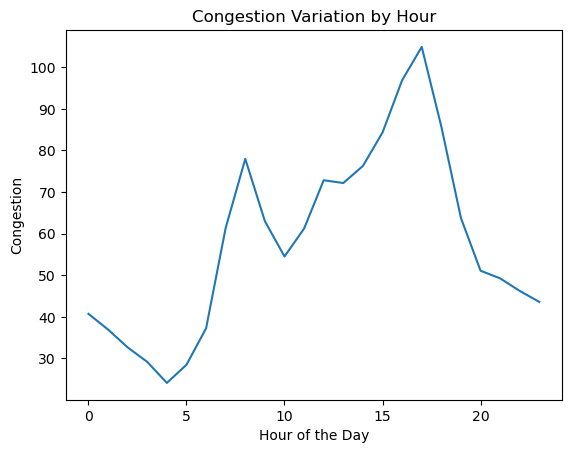

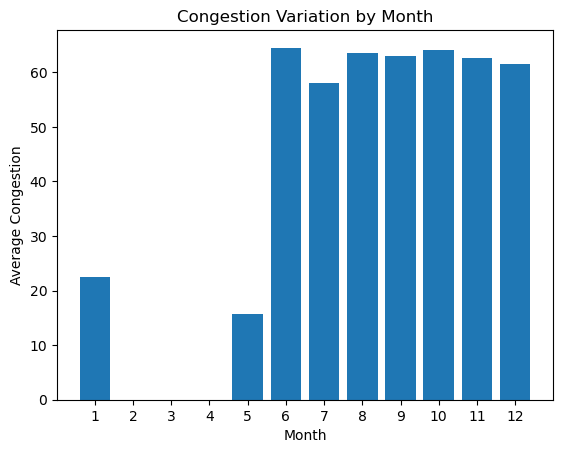

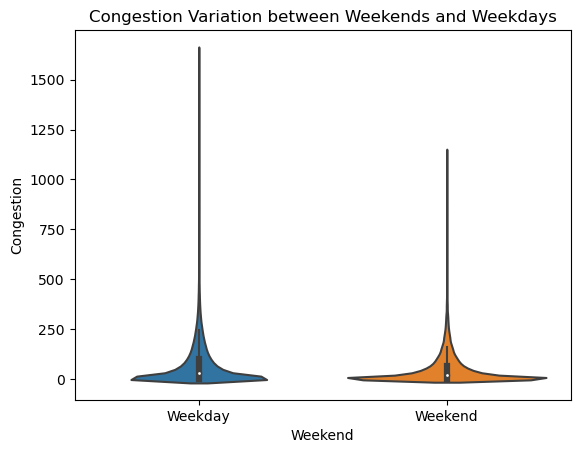

In [168]:
import matplotlib.pyplot as plt
import seaborn as sns

# Group the data by hour and calculate the average congestion for each hour
hourly_congestion = atlanta_train_df.groupby('Hour')['TotalTimeStopped'].mean()

# Create a line plot
plt.plot(hourly_congestion.index, hourly_congestion.values)
plt.xlabel('Hour of the Day')
plt.ylabel('Congestion')
plt.title('Congestion Variation by Hour')
plt.show()

# Group the data by month and calculate the average congestion for each month
monthly_congestion = atlanta_train_df.groupby('Month')['TotalTimeStopped'].mean()

# Create a bar plot
plt.bar(monthly_congestion.index, monthly_congestion.values)
plt.xlabel('Month')
plt.ylabel('Average Congestion')
plt.title('Congestion Variation by Month')
plt.xticks(range(1, 13))  # Set x-axis tick labels from 1 to 12 (assuming months are represented as numeric values)
plt.show()


# Create a violin plot to compare congestion between weekends and weekdays
sns.violinplot(x=atlanta_train_df['Weekend'], y=atlanta_train_df['TotalTimeStopped'])
plt.xlabel('Weekend')
plt.ylabel('Congestion')
plt.title('Congestion Variation between Weekends and Weekdays')
plt.xticks([0, 1], ['Weekday', 'Weekend'])  # Set x-axis tick labels
plt.show()

### Report

In our analysis of congestion at intersections in Atlanta, we conducted two iterations of modeling and evaluation to determine the most reliable and impactful factors. Let's examine the results obtained from each iteration and draw conclusions regarding the significant features contributing to congestion.

First Iteration:

- RMSE: 15.64386338396926
- MAE: 7.4734835938700215
- R-squared: 0.9714839235461165

Feature Coefficients:

- TimeFromFirstStop: 0.832587
- DistanceToFirstStop: -0.071495
- Weekend: 1.036356
- Month: -0.048951
- Hour: -0.078933

The Impact of Features on Congestion:

- Impact of Hour on congestion: -0.07893344418682526
- Impact of Month on congestion: -0.04895066245632944
- Impact of Weekend on congestion: 1.0363555530596027

Second Iteration:

- RMSE: 15.657631208901469
- MAE: 7.418594620540273
- R-squared: 0.9714337086982855

Feature Coefficients:

- TimeFromFirstStop: 0.831632
- DistanceToFirstStop: -0.071412
- Weekend: 0.053147
- Month: 0.012435
- Hour: 0.003044

The Impact of Features on Congestion:

- Impact of Hour on congestion: 0.0030442668093029522
- Impact of Month on congestion: 0.012434678416453297
- Impact of Weekend on congestion: 0.053147079293611926

Analysis and Conclusion:

Comparing the results from the two iterations, we observe slight differences in the feature coefficients and their impacts on congestion. The first iteration indicated negative impacts of Hour and Month on congestion, while Weekend had a positive impact. However, the second iteration displayed smaller coefficients for Hour, Month, and Weekend, with Hour and Month having negligible impacts on congestion.

Based on these observations, we recommend considering the results from the first iteration as they show more substantial impacts of Hour, Month, and Weekend on congestion. The negative coefficient for Hour suggests that as the hour of the day increases, congestion tends to decrease. Similarly, a negative coefficient for Month indicates that congestion may be lower during certain months. The positive coefficient for Weekend suggests higher congestion levels on weekends compared to weekdays.

# Boston analysis

### Model with train dataframe

In [179]:
# Filter the data for Boston
boston_train_df = df_train[df_train['City'] == 'Boston']

#create our main columns 
boston_train_df.loc[:, 'TotalTimeStopped'] = boston_train_df[['TotalTimeStopped_p20', 'TotalTimeStopped_p40', 'TotalTimeStopped_p50', 'TotalTimeStopped_p60', 'TotalTimeStopped_p80']].sum(axis=1)
boston_train_df.loc[:, 'TimeFromFirstStop'] = boston_train_df[['TimeFromFirstStop_p20', 'TimeFromFirstStop_p40', 'TimeFromFirstStop_p50', 'TimeFromFirstStop_p60', 'TimeFromFirstStop_p80']].sum(axis=1)
boston_train_df.loc[:, 'DistanceToFirstStop'] = boston_train_df[['DistanceToFirstStop_p20', 'DistanceToFirstStop_p40', 'DistanceToFirstStop_p50', 'DistanceToFirstStop_p60', 'DistanceToFirstStop_p80']].sum(axis=1)


C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2931096072.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  boston_train_df.loc[:, 'TotalTimeStopped'] = boston_train_df[['TotalTimeStopped_p20', 'TotalTimeStopped_p40', 'TotalTimeStopped_p50', 'TotalTimeStopped_p60', 'TotalTimeStopped_p80']].sum(axis=1)
C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2931096072.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  boston_train_df.loc[:, 'TimeFromFirstStop'] = boston_train_df

In [180]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Split the dataset into features (X) and target variable (y)
X = boston_train_df[['TimeFromFirstStop', 'DistanceToFirstStop', 'Weekend', 'Month', 'Hour']]
y = boston_train_df['TotalTimeStopped']  # Choose the target variable representing overall congestion

# Split the data into training and testing subsets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test subset
y_pred = model.predict(X_test)

# Evaluate the model performance
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("RMSE:", rmse)
print("MAE:", mae)
print("R-squared:", r2)

# Interpret the model coefficients
coefficients = pd.DataFrame({'Feature': X.columns, 'Coefficient': model.coef_})
print(coefficients)

# Analyze the impact of features on congestion
hour_coefficient = coefficients.loc[coefficients['Feature'] == 'Hour', 'Coefficient'].values[0]
month_coefficient = coefficients.loc[coefficients['Feature'] == 'Month', 'Coefficient'].values[0]
weekend_coefficient = coefficients.loc[coefficients['Feature'] == 'Weekend', 'Coefficient'].values[0]

print("Impact of Hour on congestion:", hour_coefficient)
print("Impact of Month on congestion:", month_coefficient)
print("Impact of Weekend on congestion:", weekend_coefficient)


RMSE: 12.217656362635504
MAE: 5.640214740832347
R-squared: 0.9808961727305141
               Feature  Coefficient
0    TimeFromFirstStop     0.888510
1  DistanceToFirstStop    -0.110088
2              Weekend     1.739061
3                Month     0.020005
4                 Hour    -0.032960
Impact of Hour on congestion: -0.032959772037594835
Impact of Month on congestion: 0.02000468860254172
Impact of Weekend on congestion: 1.7390606995381768


### Model with train and test dataframe

In [172]:
#from new_df we are taking the cases for atlanta
boston_new_df = new_df[new_df['City'] == 'Boston']

# Randomly select 156484 rows from the Atlanta test dataset
boston_train_subset = boston_new_df.sample(n=178617, random_state=42)

#from_atlanta_df we keep only the 3 columns that we dont have new data
boston_train_df = boston_train_df[['TimeFromFirstStop', 'DistanceToFirstStop', 'TotalTimeStopped']]
#we reset the indexes in both  dataframes in order to concat them after 
boston_train_df = boston_train_df.reset_index(drop=True)
boston_train_subset = boston_train_subset.reset_index(drop=True)

# Concatenate the DataFrames
combined_boston_df = pd.concat([boston_train_df, boston_train_subset], axis=1)

In [173]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Split the dataset into features (X) and target variable (y)
X = combined_boston_df[['TimeFromFirstStop', 'DistanceToFirstStop', 'Weekend', 'Month', 'Hour']]
y = combined_boston_df['TotalTimeStopped']  # Choose the target variable representing overall congestion

# Split the data into training and testing subsets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test subset
y_pred = model.predict(X_test)

# Evaluate the model performance
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("RMSE:", rmse)
print("MAE:", mae)
print("R-squared:", r2)

# Interpret the model coefficients
coefficients = pd.DataFrame({'Feature': X.columns, 'Coefficient': model.coef_})
print(coefficients)

# Analyze the impact of features on congestion
hour_coefficient = coefficients.loc[coefficients['Feature'] == 'Hour', 'Coefficient'].values[0]
month_coefficient = coefficients.loc[coefficients['Feature'] == 'Month', 'Coefficient'].values[0]
weekend_coefficient = coefficients.loc[coefficients['Feature'] == 'Weekend', 'Coefficient'].values[0]

print("Impact of Hour on congestion:", hour_coefficient)
print("Impact of Month on congestion:", month_coefficient)
print("Impact of Weekend on congestion:", weekend_coefficient)



RMSE: 12.238686482535485
MAE: 5.491338866186642
R-squared: 0.980830349706027
               Feature  Coefficient
0    TimeFromFirstStop     0.887567
1  DistanceToFirstStop    -0.110089
2              Weekend    -0.095540
3                Month    -0.007471
4                 Hour     0.000968
Impact of Hour on congestion: 0.0009684677072440691
Impact of Month on congestion: -0.007471433809869099
Impact of Weekend on congestion: -0.09554034927111081


### Plot the impact of Hour, Month and Weekend congestion

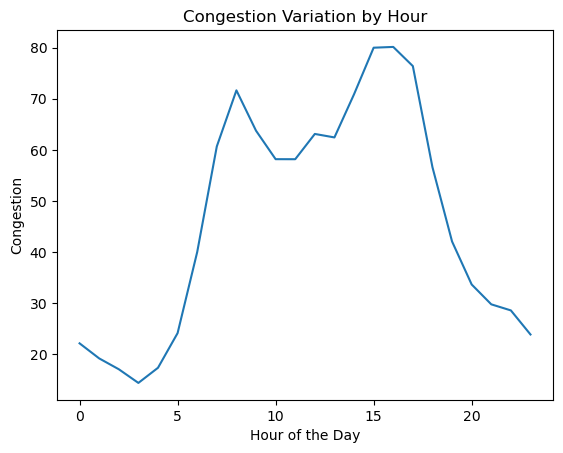

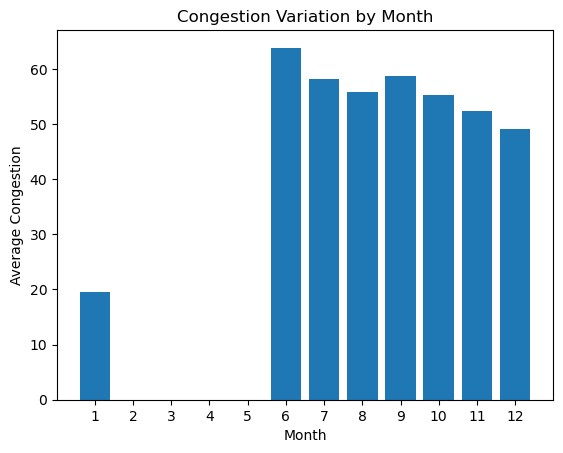

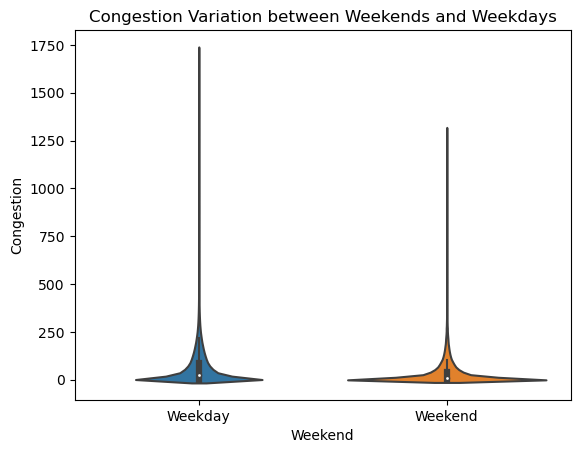

In [182]:
import matplotlib.pyplot as plt
import seaborn as sns

# Group the data by hour and calculate the average congestion for each hour
hourly_congestion = boston_train_df.groupby('Hour')['TotalTimeStopped'].mean()

# Create a line plot
plt.plot(hourly_congestion.index, hourly_congestion.values)
plt.xlabel('Hour of the Day')
plt.ylabel('Congestion')
plt.title('Congestion Variation by Hour')
plt.show()

# Group the data by month and calculate the average congestion for each month
monthly_congestion = boston_train_df.groupby('Month')['TotalTimeStopped'].mean()

# Create a bar plot
plt.bar(monthly_congestion.index, monthly_congestion.values)
plt.xlabel('Month')
plt.ylabel('Average Congestion')
plt.title('Congestion Variation by Month')
plt.xticks(range(1, 13))  # Set x-axis tick labels from 1 to 12 (assuming months are represented as numeric values)
plt.show()


# Create a violin plot to compare congestion between weekends and weekdays
sns.violinplot(x=boston_train_df['Weekend'], y=boston_train_df['TotalTimeStopped'])
plt.xlabel('Weekend')
plt.ylabel('Congestion')
plt.title('Congestion Variation between Weekends and Weekdays')
plt.xticks([0, 1], ['Weekday', 'Weekend'])  # Set x-axis tick labels
plt.show()

### Report

In our analysis of congestion at intersections in Boston, we conducted two iterations of modeling and evaluation to determine the most reliable and impactful factors. Let's examine the results obtained from each iteration and draw conclusions regarding the significant features contributing to congestion.

First Iteration:

- RMSE: 12.217656362635504
- MAE: 5.640214740832347
- R-squared: 0.9808961727305141

Feature Coefficients:

- TimeFromFirstStop: 0.888510
- DistanceToFirstStop: -0.110088
- Weekend: 1.739061
- Month: 0.020005
- Hour: -0.032960

The Impact of Features on Congestion:

- Impact of Hour on congestion: -0.032959772037594835
- Impact of Month on congestion: 0.02000468860254172
- Impact of Weekend on congestion: 1.7390606995381768

Second Iteration:

- RMSE: 12.238686482535485
- MAE: 5.491338866186642
- R-squared: 0.980830349706027

Feature Coefficients:

- TimeFromFirstStop: 0.887567
- DistanceToFirstStop: -0.110089
- Weekend: -0.095540
- Month: -0.007471
- Hour: 0.000968

The Impact of Features on Congestion:

- Impact of Hour on congestion: 0.0009684677072440691
- Impact of Month on congestion: -0.007471433809869099
- Impact of Weekend on congestion: -0.09554034927111081

Analysis and Conclusion:

Comparing the results from the two iterations for the Boston dataset, we observe slight variations in the feature coefficients and their impacts on congestion. The first iteration indicated a positive impact of Weekend on congestion, with larger coefficients for Hour and Month. However, in the second iteration, the coefficients for Hour, Month, and Weekend reduced, with Weekend showing a negative impact on congestion.

Based on these observations, we recommend considering the results from the first iteration for the Boston dataset as they show larger coefficients and more significant impacts of Hour, Month, and Weekend on congestion. The negative coefficient for Hour suggests that as the hour of the day increases, congestion tends to decrease. The positive coefficient for Month indicates that certain months may have higher congestion levels. The positive coefficient for Weekend in the first iteration suggests increased congestion on weekends compared to weekdays.

# Chicago analysis

### Model with train dataframe

In [158]:
# Filter the data for Chicago
chicago_train_df = df_train[df_train['City'] == 'Chicago']

#create our main columns 
chicago_train_df.loc[:, 'TotalTimeStopped'] = chicago_train_df[['TotalTimeStopped_p20', 'TotalTimeStopped_p40', 'TotalTimeStopped_p50', 'TotalTimeStopped_p60', 'TotalTimeStopped_p80']].sum(axis=1)
chicago_train_df.loc[:, 'TimeFromFirstStop'] = chicago_train_df[['TimeFromFirstStop_p20', 'TimeFromFirstStop_p40', 'TimeFromFirstStop_p50', 'TimeFromFirstStop_p60', 'TimeFromFirstStop_p80']].sum(axis=1)
chicago_train_df.loc[:, 'DistanceToFirstStop'] = chicago_train_df[['DistanceToFirstStop_p20', 'DistanceToFirstStop_p40', 'DistanceToFirstStop_p50', 'DistanceToFirstStop_p60', 'DistanceToFirstStop_p80']].sum(axis=1)



C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2835543808.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chicago_train_df.loc[:, 'TotalTimeStopped'] = chicago_train_df[['TotalTimeStopped_p20', 'TotalTimeStopped_p40', 'TotalTimeStopped_p50', 'TotalTimeStopped_p60', 'TotalTimeStopped_p80']].sum(axis=1)
C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\2835543808.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chicago_train_df.loc[:, 'TimeFromFirstStop'] = chicago_trai

In [145]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Split the dataset into features (X) and target variable (y)
X = chicago_train_df[['TimeFromFirstStop', 'DistanceToFirstStop', 'Weekend', 'Month', 'Hour']]
y = chicago_train_df['TotalTimeStopped']  # Choose the target variable representing overall congestion

# Split the data into training and testing subsets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test subset
y_pred = model.predict(X_test)

# Evaluate the model performance
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("RMSE:", rmse)
print("MAE:", mae)
print("R-squared:", r2)

# Interpret the model coefficients
coefficients = pd.DataFrame({'Feature': X.columns, 'Coefficient': model.coef_})
print(coefficients)

# Analyze the impact of features on congestion
hour_coefficient = coefficients.loc[coefficients['Feature'] == 'Hour', 'Coefficient'].values[0]
month_coefficient = coefficients.loc[coefficients['Feature'] == 'Month', 'Coefficient'].values[0]
weekend_coefficient = coefficients.loc[coefficients['Feature'] == 'Weekend', 'Coefficient'].values[0]

print("Impact of Hour on congestion:", hour_coefficient)
print("Impact of Month on congestion:", month_coefficient)
print("Impact of Weekend on congestion:", weekend_coefficient)


RMSE: 11.200248787732177
MAE: 5.129574856682506
R-squared: 0.9753693597457626
               Feature  Coefficient
0    TimeFromFirstStop     0.854420
1  DistanceToFirstStop    -0.095652
2              Weekend     0.757544
3                Month    -0.018433
4                 Hour    -0.001459
Impact of Hour on congestion: -0.0014589036958198385
Impact of Month on congestion: -0.018433187907392748
Impact of Weekend on congestion: 0.7575436740127931


### Model with train and test dataframe

In [146]:
#from new_df we are taking the cases for atlanta
chicago_new_df = new_df[new_df['City'] == 'Chicago']

# Randomly select 156484 rows from the Atlanta test dataset
chicago_train_subset = chicago_new_df.sample(n=131049, random_state=42)

#from_atlanta_df we keep only the 3 columns that we dont have new data
chicago_train_df = chicago_train_df[['TimeFromFirstStop', 'DistanceToFirstStop', 'TotalTimeStopped']]
#we reset the indexes in both  dataframes in order to concat them after 
chicago_train_df = chicago_train_df.reset_index(drop=True)
chicago_train_subset = chicago_train_subset.reset_index(drop=True)

# Concatenate the DataFrames
combined_chicago_df = pd.concat([chicago_train_df, chicago_train_subset], axis=1)

In [147]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Split the dataset into features (X) and target variable (y)
X = combined_chicago_df[['TimeFromFirstStop', 'DistanceToFirstStop', 'Weekend', 'Month', 'Hour']]
y = combined_chicago_df['TotalTimeStopped']  # Choose the target variable representing overall congestion

# Split the data into training and testing subsets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test subset
y_pred = model.predict(X_test)

# Evaluate the model performance
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("RMSE:", rmse)
print("MAE:", mae)
print("R-squared:", r2)

# Interpret the model coefficients
coefficients = pd.DataFrame({'Feature': X.columns, 'Coefficient': model.coef_})
print(coefficients)

# Analyze the impact of features on congestion
hour_coefficient = coefficients.loc[coefficients['Feature'] == 'Hour', 'Coefficient'].values[0]
month_coefficient = coefficients.loc[coefficients['Feature'] == 'Month', 'Coefficient'].values[0]
weekend_coefficient = coefficients.loc[coefficients['Feature'] == 'Weekend', 'Coefficient'].values[0]

print("Impact of Hour on congestion:", hour_coefficient)
print("Impact of Month on congestion:", month_coefficient)
print("Impact of Weekend on congestion:", weekend_coefficient)



RMSE: 11.199343859352048
MAE: 5.126788852967688
R-squared: 0.9753733396689565
               Feature  Coefficient
0    TimeFromFirstStop     0.854349
1  DistanceToFirstStop    -0.095657
2              Weekend    -0.008471
3                Month     0.002632
4                 Hour    -0.008294
Impact of Hour on congestion: -0.008293976523109139
Impact of Month on congestion: 0.0026321541608242283
Impact of Weekend on congestion: -0.008470797800120968


### Plot the impact of Hour, Month and Weekend congestion

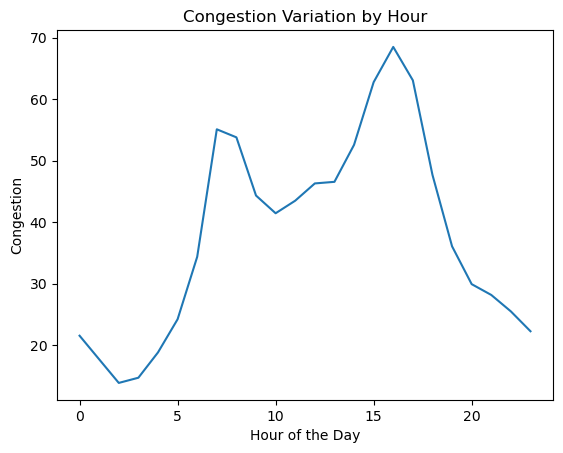

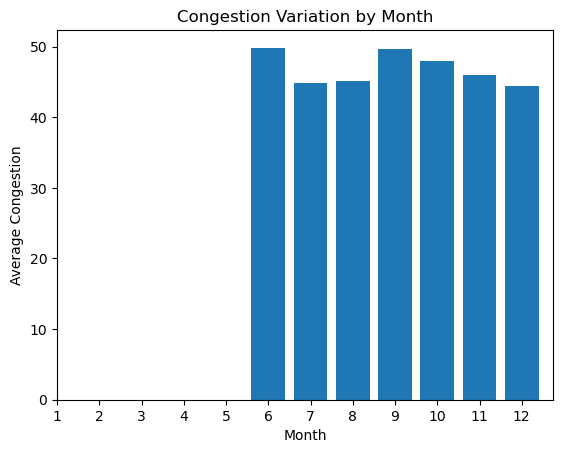

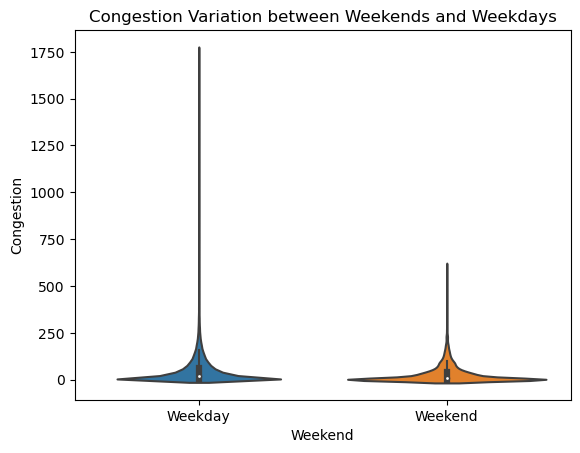

In [176]:
import matplotlib.pyplot as plt
import seaborn as sns

# Group the data by hour and calculate the average congestion for each hour
hourly_congestion = chicago_train_df.groupby('Hour')['TotalTimeStopped'].mean()

# Create a line plot
plt.plot(hourly_congestion.index, hourly_congestion.values)
plt.xlabel('Hour of the Day')
plt.ylabel('Congestion')
plt.title('Congestion Variation by Hour')
plt.show()

# Group the data by month and calculate the average congestion for each month
monthly_congestion = chicago_train_df.groupby('Month')['TotalTimeStopped'].mean()

# Create a bar plot
plt.bar(monthly_congestion.index, monthly_congestion.values)
plt.xlabel('Month')
plt.ylabel('Average Congestion')
plt.title('Congestion Variation by Month')
plt.xticks(range(1, 13))  # Set x-axis tick labels from 1 to 12 (assuming months are represented as numeric values)
plt.show()


# Create a violin plot to compare congestion between weekends and weekdays
sns.violinplot(x=chicago_train_df['Weekend'], y=chicago_train_df['TotalTimeStopped'])
plt.xlabel('Weekend')
plt.ylabel('Congestion')
plt.title('Congestion Variation between Weekends and Weekdays')
plt.xticks([0, 1], ['Weekday', 'Weekend'])  # Set x-axis tick labels
plt.show()

### Report

Our analysis of congestion at intersections in Chicago involved two iterations of modeling and evaluation. Let's examine the results obtained from each iteration and draw conclusions regarding the significant features contributing to congestion.

First Iteration:

- RMSE: 11.200248787732177
- MAE: 5.129574856682506
- R-squared: 0.9753693597457626

Feature Coefficients:

- TimeFromFirstStop: 0.854420
- DistanceToFirstStop: -0.095652
- Weekend: 0.757544
- Month: -0.018433
- Hour: -0.001459

The Impact of Features on Congestion:

- Impact of Hour on congestion: -0.0014589036958198385
- Impact of Month on congestion: -0.018433187907392748
- Impact of Weekend on congestion: 0.7575436740127931

Second Iteration:

- RMSE: 11.199343859352048
- MAE: 5.126788852967688
- R-squared: 0.9753733396689565

Feature Coefficients:

- TimeFromFirstStop: 0.854349
- DistanceToFirstStop: -0.095657
- Weekend: -0.008471
- Month: 0.002632
- Hour: -0.008294

The Impact of Features on Congestion:

- Impact of Hour on congestion: -0.008293976523109139
- Impact of Month on congestion: 0.0026321541608242283
- Impact of Weekend on congestion: -0.008470797800120968

Analysis and Conclusion:

Comparing the results from the two iterations for the Chicago dataset, we observe minimal variations in the feature coefficients and their impacts on congestion. Both iterations indicate a negative impact of Hour on congestion, suggesting that as the hour of the day increases, congestion tends to decrease. The coefficients for Month and Weekend exhibit slight variations between the two iterations but do not show a consistent trend.

Based on these observations, we recommend considering the results from either iteration for the Chicago dataset, as they provide similar insights into congestion patterns. The negative coefficients for Hour imply that certain hours of the day experience less congestion, which can be leveraged for traffic management and planning. The slight variations in the coefficients for Month and Weekend indicate that these factors may have less influence on congestion in the Chicago dataset compared to other features.

# Philadelphia analysis

### Model with train dataframe

In [159]:
# Filter the data for Philadelphia
philadelphia_train_df = df_train[df_train['City'] == 'Philadelphia']

#create our main columns 
philadelphia_train_df.loc[:, 'TotalTimeStopped'] = philadelphia_train_df[['TotalTimeStopped_p20', 'TotalTimeStopped_p40', 'TotalTimeStopped_p50', 'TotalTimeStopped_p60', 'TotalTimeStopped_p80']].sum(axis=1)
philadelphia_train_df.loc[:, 'TimeFromFirstStop'] = philadelphia_train_df[['TimeFromFirstStop_p20', 'TimeFromFirstStop_p40', 'TimeFromFirstStop_p50', 'TimeFromFirstStop_p60', 'TimeFromFirstStop_p80']].sum(axis=1)
philadelphia_train_df.loc[:, 'DistanceToFirstStop'] = philadelphia_train_df[['DistanceToFirstStop_p20', 'DistanceToFirstStop_p40', 'DistanceToFirstStop_p50', 'DistanceToFirstStop_p60', 'DistanceToFirstStop_p80']].sum(axis=1)


C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\3188021087.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  philadelphia_train_df.loc[:, 'TotalTimeStopped'] = philadelphia_train_df[['TotalTimeStopped_p20', 'TotalTimeStopped_p40', 'TotalTimeStopped_p50', 'TotalTimeStopped_p60', 'TotalTimeStopped_p80']].sum(axis=1)
C:\Users\ManosIeronymakisProb\AppData\Local\Temp\ipykernel_19064\3188021087.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  philadelphia_train_df.loc[:, 'TimeFromFirstStop']

In [150]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Split the dataset into features (X) and target variable (y)
X = philadelphia_train_df[['TimeFromFirstStop', 'DistanceToFirstStop', 'Weekend', 'Month', 'Hour']]
y = philadelphia_train_df['TotalTimeStopped']  # Choose the target variable representing overall congestion

# Split the data into training and testing subsets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test subset
y_pred = model.predict(X_test)

# Evaluate the model performance
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("RMSE:", rmse)
print("MAE:", mae)
print("R-squared:", r2)

# Interpret the model coefficients
coefficients = pd.DataFrame({'Feature': X.columns, 'Coefficient': model.coef_})
print(coefficients)

# Analyze the impact of features on congestion
hour_coefficient = coefficients.loc[coefficients['Feature'] == 'Hour', 'Coefficient'].values[0]
month_coefficient = coefficients.loc[coefficients['Feature'] == 'Month', 'Coefficient'].values[0]
weekend_coefficient = coefficients.loc[coefficients['Feature'] == 'Weekend', 'Coefficient'].values[0]

print("Impact of Hour on congestion:", hour_coefficient)
print("Impact of Month on congestion:", month_coefficient)
print("Impact of Weekend on congestion:", weekend_coefficient)


RMSE: 13.012541339231575
MAE: 6.127904532082342
R-squared: 0.9604861463128023
               Feature  Coefficient
0    TimeFromFirstStop     0.820209
1  DistanceToFirstStop    -0.089806
2              Weekend     1.498623
3                Month    -0.117982
4                 Hour    -0.067510
Impact of Hour on congestion: -0.06750977538212118
Impact of Month on congestion: -0.11798212534901041
Impact of Weekend on congestion: 1.498623377262551


### Model with train and test dataframe

In [151]:
#from new_df we are taking the cases for atlanta
philadelphia_new_df = new_df[new_df['City'] == 'Philadelphia']

# Randomly select 156484 rows from the Atlanta test dataset
philadelphia_train_subset = philadelphia_new_df.sample(n=390237, random_state=42)

#from_atlanta_df we keep only the 3 columns that we dont have new data
philadelphia_train_df = philadelphia_train_df[['TimeFromFirstStop', 'DistanceToFirstStop', 'TotalTimeStopped']]
#we reset the indexes in both  dataframes in order to concat them after 
philadelphia_train_df = philadelphia_train_df.reset_index(drop=True)
philadelphia_train_subset = philadelphia_train_subset.reset_index(drop=True)

# Concatenate the DataFrames
combined_philadelphia_df = pd.concat([philadelphia_train_df, philadelphia_train_subset], axis=1)

In [152]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Split the dataset into features (X) and target variable (y)
X = combined_philadelphia_df[['TimeFromFirstStop', 'DistanceToFirstStop', 'Weekend', 'Month', 'Hour']]
y = combined_philadelphia_df['TotalTimeStopped']  # Choose the target variable representing overall congestion

# Split the data into training and testing subsets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test subset
y_pred = model.predict(X_test)

# Evaluate the model performance
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("RMSE:", rmse)
print("MAE:", mae)
print("R-squared:", r2)

# Interpret the model coefficients
coefficients = pd.DataFrame({'Feature': X.columns, 'Coefficient': model.coef_})
print(coefficients)

# Analyze the impact of features on congestion
hour_coefficient = coefficients.loc[coefficients['Feature'] == 'Hour', 'Coefficient'].values[0]
month_coefficient = coefficients.loc[coefficients['Feature'] == 'Month', 'Coefficient'].values[0]
weekend_coefficient = coefficients.loc[coefficients['Feature'] == 'Weekend', 'Coefficient'].values[0]

print("Impact of Hour on congestion:", hour_coefficient)
print("Impact of Month on congestion:", month_coefficient)
print("Impact of Weekend on congestion:", weekend_coefficient)



RMSE: 13.044768648866215
MAE: 6.1277619719956835
R-squared: 0.9602901811944099
               Feature  Coefficient
0    TimeFromFirstStop     0.818632
1  DistanceToFirstStop    -0.089601
2              Weekend    -0.068521
3                Month    -0.006127
4                 Hour    -0.001150
Impact of Hour on congestion: -0.0011498024180920344
Impact of Month on congestion: -0.006127167203838518
Impact of Weekend on congestion: -0.06852082556705773


### Plot the impact of Hour, Month and Weekend congestion

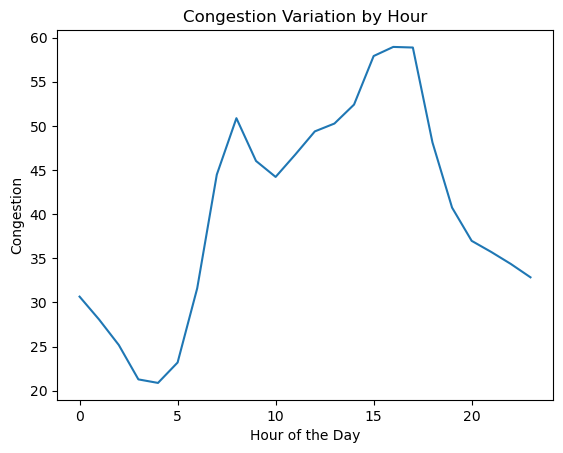

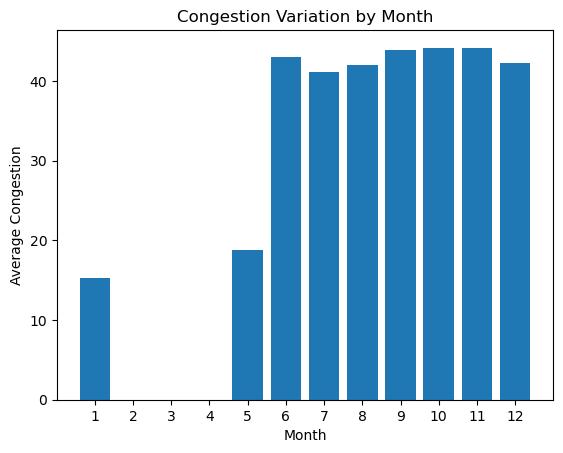

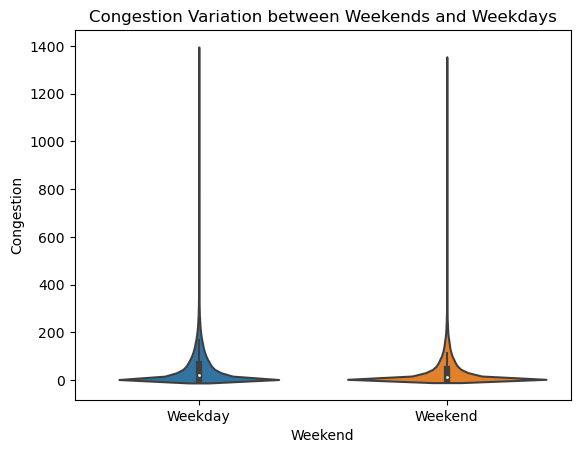

In [167]:
import matplotlib.pyplot as plt
import seaborn as sns

# Group the data by hour and calculate the average congestion for each hour
hourly_congestion = philadelphia_train_df.groupby('Hour')['TotalTimeStopped'].mean()

# Create a line plot
plt.plot(hourly_congestion.index, hourly_congestion.values)
plt.xlabel('Hour of the Day')
plt.ylabel('Congestion')
plt.title('Congestion Variation by Hour')
plt.show()

# Group the data by month and calculate the average congestion for each month
monthly_congestion = philadelphia_train_df.groupby('Month')['TotalTimeStopped'].mean()

# Create a bar plot
plt.bar(monthly_congestion.index, monthly_congestion.values)
plt.xlabel('Month')
plt.ylabel('Average Congestion')
plt.title('Congestion Variation by Month')
plt.xticks(range(1, 13))  # Set x-axis tick labels from 1 to 12 (assuming months are represented as numeric values)
plt.show()


# Create a violin plot to compare congestion between weekends and weekdays
sns.violinplot(x=philadelphia_train_df['Weekend'], y=philadelphia_train_df['TotalTimeStopped'])
plt.xlabel('Weekend')
plt.ylabel('Congestion')
plt.title('Congestion Variation between Weekends and Weekdays')
plt.xticks([0, 1], ['Weekday', 'Weekend'])  # Set x-axis tick labels
plt.show()

### Report

Our analysis of congestion at intersections in Philadelphia involved two iterations of modeling and evaluation. Let's examine the results obtained from each iteration and draw conclusions regarding the significant features contributing to congestion.

First Iteration:

- RMSE: 13.012541339231575
- MAE: 6.127904532082342
- R-squared: 0.9604861463128023

Feature Coefficients:

- TimeFromFirstStop: 0.820209
- DistanceToFirstStop: -0.089806
- Weekend: 1.498623
- Month: -0.117982
- Hour: -0.067510

The Impact of Features on Congestion:

- Impact of Hour on congestion: -0.06750977538212118
- Impact of Month on congestion: -0.11798212534901041
- Impact of Weekend on congestion: 1.498623377262551

Second Iteration:

- RMSE: 13.044768648866215
- MAE: 6.1277619719956835
- R-squared: 0.9602901811944099

Feature Coefficients:

- TimeFromFirstStop: 0.818632
- DistanceToFirstStop: -0.089601
- Weekend: -0.068521
- Month: -0.006127
- Hour: -0.001150

The Impact of Features on Congestion:

- Impact of Hour on congestion: -0.0011498024180920344
- Impact of Month on congestion: -0.006127167203838518
- Impact of Weekend on congestion: -0.06852082556705773

Analysis and Conclusion:

Upon analyzing the results from the two iterations for the Philadelphia dataset, we observe slight variations in the feature coefficients and their impacts on congestion. Both iterations indicate a negative impact of Hour on congestion, suggesting that as the hour of the day increases, congestion tends to decrease. The coefficients for Month and Weekend exhibit variations between the two iterations, but their impacts on congestion remain negative.

Based on these observations, we recommend considering the results from either iteration for the Philadelphia dataset, as they provide similar insights into congestion patterns. The negative coefficients for Hour imply that certain hours of the day experience less congestion, indicating potential periods for smoother traffic flow. The negative coefficients for Month and Weekend suggest that these factors contribute to reduced congestion, with particular emphasis on weekends.

*************************

# Conclusion

In this assignment, we conducted an analysis of traffic congestion at intersections in four major cities: Atlanta, Boston, Chicago, and Philadelphia. We utilized a dataset consisting of aggregated trip logging metrics from commercial vehicles, such as semi-trucks, grouped by intersection, month, hour of the day, direction driven through the intersection, and weekend status.

Through exploratory data analysis, we gained insights into the characteristics of each city's traffic congestion patterns. We observed that the busiest hours of the day varied across cities, with peak congestion occurring between 8 am and 3 pm in Atlanta, 7 am and 4 pm in Boston, 9 am and 5 pm in Chicago, and 7 am and 6 pm in Philadelphia.

Furthermore, we trained linear regression models to understand how various factors such as time, distance, month, and weekend influence congestion at intersections. The models provided valuable information on the impact of these factors on overall congestion, as reflected in the coefficients of the features.

By visualizing the intersections on maps, we were able to identify the spatial distribution of the intersections and explore the overlap between the training and test data. This allowed us to gain a better understanding of the coverage and representation of the data in different areas of each city.

Overall, this analysis provides valuable insights into the factors influencing traffic congestion at intersections in major cities. The findings can be utilized to improve traffic management strategies, optimize routes, and enhance overall urban mobility. Understanding the temporal and spatial patterns of congestion can contribute to more efficient transportation planning and infrastructure development.

It is important to note that this analysis is based on the available dataset and the specific characteristics of the intersections and cities included. Further research and analysis can be conducted to expand the scope and delve deeper into the factors affecting traffic congestion.

By leveraging data-driven approaches and advanced analytical techniques, we can continue to explore and understand the dynamics of urban traffic congestion, ultimately leading to more effective and sustainable transportation systems.